In [3]:
from ultralytics import YOLO
import os
import cv2
import numpy as np
from tqdm import tqdm
import shutil

In [9]:
hsv_path = "../yolo_hsv/images"
thermal_path = "../yolo_t_grayscale/images"
output_path =  "images"


In [11]:
import os
import cv2
import numpy as np
from tqdm import tqdm

splits = ["train", "val", "test"]
for split in splits:
    hsv_dir = os.path.join(hsv_path, split)          # imágenes HSV existentes
    thermal_dir = os.path.join(thermal_path, split)  # imágenes térmicas (grayscale)
    out_dir = os.path.join(output_path, split)       # carpeta destino
    os.makedirs(out_dir, exist_ok=True)

    hsv_files = sorted(os.listdir(hsv_dir))
    thermal_files = sorted(os.listdir(thermal_dir))

    # Asegurar que tengan la misma cantidad
    if len(hsv_files) != len(thermal_files):
        print(f"Error: cantidad de imágenes no coincide en split '{split}'")
        continue

    for i, (hsv_fname, thermal_fname) in enumerate(tqdm(zip(hsv_files, thermal_files), total=len(hsv_files), desc=f"Procesando {split}")):
        hsv_img = cv2.imread(os.path.join(hsv_dir, hsv_fname))             # en BGR pero con valores HSV
        thermal_img = cv2.imread(os.path.join(thermal_dir, thermal_fname), cv2.IMREAD_GRAYSCALE)

        if hsv_img is None:
            print(f"Warning: No se pudo cargar HSV {hsv_fname}. Saltando.")
            continue
        if thermal_img is None:
            print(f"Warning: No se pudo cargar térmica {thermal_fname}. Saltando.")
            continue

        # Separar canales H y S
        h, s, _ = cv2.split(hsv_img)

        # Redimensionar térmica si no coincide
        if thermal_img.shape != h.shape:
            thermal_img = cv2.resize(thermal_img, (h.shape[1], h.shape[0]))

        # Reemplazar canal V por imagen térmica
        hsv_modified = cv2.merge([h, s, thermal_img])

        # Nuevo nombre
        new_name = f"hst_{split}_{i}.jpg"
        out_path = os.path.join(out_dir, new_name)

        cv2.imwrite(out_path, hsv_modified)

Procesando test: 100%|██████████| 26/26 [00:00<00:00, 29.07it/s]


In [12]:
import os
from tqdm import tqdm

splits = ["train", "val", "test"]
original_labels_root = "../yolo_rgb/labels"
output_labels_root = "labels"  # donde vas a guardar los nuevos .txt renombrados

for split in splits:
    in_labels_dir = os.path.join(original_labels_root, split)
    out_labels_dir = os.path.join(output_labels_root, split)
    os.makedirs(out_labels_dir, exist_ok=True)

    label_files = sorted(os.listdir(in_labels_dir))

    for i, label_fname in enumerate(tqdm(label_files, desc=f"Renombrando labels {split}")):
        in_path = os.path.join(in_labels_dir, label_fname)
        out_name = f"hst_{split}_{i}.txt"
        out_path = os.path.join(out_labels_dir, out_name)

        with open(in_path, "r") as fin, open(out_path, "w") as fout:
            fout.write(fin.read())  # copiar contenido


Renombrando labels test: 100%|██████████| 26/26 [00:00<00:00, 3250.14it/s]


In [13]:
model = YOLO("yolo11n.pt")

model.train(
    data="data.yaml",
    epochs=150,
    imgsz=960,
    batch=16,    
    device=0      
)


100%|██████████| 5.35M/5.35M [00:00<00:00, 36.5MB/s]


New https://pypi.org/project/ultralytics/8.3.160 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.155  Python-3.10.18 torch-2.7.1+cu128 CUDA:0 (NVIDIA GeForce RTX 4070, 12282MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=150, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=960, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optim

train: Scanning C:\Users\Ciro\Desktop\cuatri\vision\tps\VisionFinal\yolo_hst\labels\train... 112 images, 0 backgrounds, 0 corrupt: 100%|██████████| 112/112 [00:00<00:00, 991.15it/s]

train: New cache created: C:\Users\Ciro\Desktop\cuatri\vision\tps\VisionFinal\yolo_hst\labels\train.cache


val: Fast image access  (ping: 0.00.0 ms, read: 188.928.5 MB/s, size: 1111.2 KB)


val: Scanning C:\Users\Ciro\Desktop\cuatri\vision\tps\VisionFinal\yolo_hst\labels\val... 26 images, 0 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<00:00, 553.20it/s]

val: New cache created: C:\Users\Ciro\Desktop\cuatri\vision\tps\VisionFinal\yolo_hst\labels\val.cache


Plotting labels to runs\detect\train\labels.jpg... 
WARNING module 'matplotlib.cm' has no attribute 'register_cmap'
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 960 train, 960 val
Using 8 dataloader workers
Logging results to runs\detect\train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/150      5.08G      2.315       5.62      1.728         38        960: 100%|██████████| 7/7 [00:06<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.11it/s]

                   all         26         73    0.00337      0.178     0.0715     0.0148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/150       5.1G      2.038      4.862      1.448         73        960: 100%|██████████| 7/7 [00:01<00:00,  5.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.15it/s]

                   all         26         73     0.0128      0.529     0.0703     0.0232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/150      5.11G       1.81      4.017      1.268         82        960: 100%|██████████| 7/7 [00:01<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.33it/s]

                   all         26         73     0.0239      0.651      0.188     0.0647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/150      5.13G      1.749       3.39       1.18         66        960: 100%|██████████| 7/7 [00:01<00:00,  6.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.32it/s]

                   all         26         73     0.0296      0.626       0.23     0.0592

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      5/150      5.14G      1.725      3.075      1.247         63        960: 100%|██████████| 7/7 [00:01<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.58it/s]

                   all         26         73     0.0457      0.736      0.279      0.142



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/150      5.16G      1.658      3.164      1.233         57        960: 100%|██████████| 7/7 [00:01<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.22it/s]

                   all         26         73     0.0219      0.525      0.184     0.0797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/150      5.17G      1.611      2.754      1.236         51        960: 100%|██████████| 7/7 [00:01<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.90it/s]

                   all         26         73     0.0201      0.631      0.385      0.176



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/150      5.19G      1.617      2.633      1.247         53        960: 100%|██████████| 7/7 [00:01<00:00,  6.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.99it/s]

                   all         26         73     0.0192      0.621      0.429        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/150       5.2G      1.585      2.377      1.195         66        960: 100%|██████████| 7/7 [00:01<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.41it/s]

                   all         26         73     0.0147      0.745       0.52      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/150      5.22G      1.534      2.124      1.171         83        960: 100%|██████████| 7/7 [00:01<00:00,  6.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.19it/s]

                   all         26         73          1     0.0467      0.567      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/150      5.23G       1.61      2.188      1.266         60        960: 100%|██████████| 7/7 [00:01<00:00,  6.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.35it/s]

                   all         26         73          1      0.082      0.789      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/150      5.25G      1.582      2.143       1.21         54        960: 100%|██████████| 7/7 [00:01<00:00,  6.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.25it/s]

                   all         26         73          1      0.131      0.829      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/150      5.26G      1.587      2.068      1.223         88        960: 100%|██████████| 7/7 [00:01<00:00,  6.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.80it/s]

                   all         26         73          1      0.269      0.735      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/150      5.28G      1.572      2.067      1.264         51        960: 100%|██████████| 7/7 [00:01<00:00,  6.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.80it/s]

                   all         26         73      0.994      0.506      0.878      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/150      5.29G      1.487       1.92      1.196         67        960: 100%|██████████| 7/7 [00:01<00:00,  6.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.46it/s]

                   all         26         73      0.791      0.529      0.769        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/150      5.31G      1.573      2.023      1.249         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.90it/s]

                   all         26         73      0.807      0.713       0.87      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/150      5.32G      1.533      1.847      1.225         84        960: 100%|██████████| 7/7 [00:01<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.04it/s]

                   all         26         73      0.841      0.711      0.843      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/150      5.34G      1.545      1.731      1.217         91        960: 100%|██████████| 7/7 [00:01<00:00,  6.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.46it/s]

                   all         26         73      0.904      0.789      0.924      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/150      5.35G      1.585       1.92      1.272         73        960: 100%|██████████| 7/7 [00:01<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.25it/s]

                   all         26         73      0.845      0.928      0.886      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/150      5.37G      1.514      1.814      1.276         59        960: 100%|██████████| 7/7 [00:01<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.35it/s]

                   all         26         73      0.753      0.941      0.897      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/150      5.38G      1.516      1.715      1.253         80        960: 100%|██████████| 7/7 [00:01<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.14it/s]

                   all         26         73      0.742      0.884      0.891      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/150      5.39G      1.492      1.603      1.187         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.26it/s]

                   all         26         73       0.78      0.861      0.874      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/150      5.41G      1.501      1.613      1.227         64        960: 100%|██████████| 7/7 [00:01<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.09it/s]

                   all         26         73      0.835      0.866      0.923      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/150      5.42G      1.384      1.552      1.204         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.58it/s]

                   all         26         73      0.941      0.845      0.946        0.5



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/150      5.44G      1.423      1.539      1.151         52        960: 100%|██████████| 7/7 [00:01<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.63it/s]

                   all         26         73      0.937       0.86      0.942      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/150      5.46G      1.414      1.542      1.171         96        960: 100%|██████████| 7/7 [00:01<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.46it/s]

                   all         26         73      0.925       0.92      0.945      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/150      5.47G      1.446      1.438      1.192         57        960: 100%|██████████| 7/7 [00:01<00:00,  6.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.69it/s]

                   all         26         73      0.883      0.884      0.909      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/150      5.48G      1.439      1.522      1.205         69        960: 100%|██████████| 7/7 [00:01<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.69it/s]

                   all         26         73      0.913      0.926      0.957      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/150       5.5G      1.469      1.429      1.157         87        960: 100%|██████████| 7/7 [00:01<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.63it/s]

                   all         26         73      0.917      0.937      0.954      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/150      5.51G      1.385      1.419      1.185         99        960: 100%|██████████| 7/7 [00:01<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.94it/s]

                   all         26         73      0.942       0.79      0.952      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/150      5.53G      1.402      1.378      1.167         88        960: 100%|██████████| 7/7 [00:01<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.13it/s]

                   all         26         73      0.914      0.721      0.909      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/150      5.54G      1.312      1.283      1.115         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.06it/s]

                   all         26         73      0.843      0.747      0.875      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/150      5.56G      1.403      1.362      1.199         58        960: 100%|██████████| 7/7 [00:01<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.87it/s]

                   all         26         73      0.836      0.829      0.888      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/150      5.57G      1.362      1.405      1.195         62        960: 100%|██████████| 7/7 [00:01<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.94it/s]

                   all         26         73      0.921      0.894      0.947      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/150      5.59G      1.361      1.277      1.175         69        960: 100%|██████████| 7/7 [00:01<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.00it/s]

                   all         26         73      0.932       0.92       0.97      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/150       5.6G      1.368      1.219      1.152         51        960: 100%|██████████| 7/7 [00:01<00:00,  6.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.33it/s]

                   all         26         73      0.907      0.876      0.944      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/150      5.62G      1.341      1.158      1.143         75        960: 100%|██████████| 7/7 [00:01<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.75it/s]

                   all         26         73      0.882      0.914      0.946      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/150      5.63G      1.383      1.208       1.17         56        960: 100%|██████████| 7/7 [00:01<00:00,  6.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.30it/s]

                   all         26         73      0.951      0.872      0.938      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/150      5.65G       1.31      1.208      1.184         60        960: 100%|██████████| 7/7 [00:01<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.00it/s]

                   all         26         73      0.947      0.906      0.957      0.536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/150      5.66G       1.33      1.186      1.127         45        960: 100%|██████████| 7/7 [00:01<00:00,  6.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.69it/s]

                   all         26         73      0.958      0.935      0.961       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/150      5.68G      1.321      1.208      1.124         75        960: 100%|██████████| 7/7 [00:01<00:00,  6.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.58it/s]

                   all         26         73       0.98      0.926      0.965      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/150      5.69G      1.347      1.114      1.107         91        960: 100%|██████████| 7/7 [00:01<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.35it/s]

                   all         26         73      0.972      0.928       0.97      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/150      5.71G      1.303      1.178      1.107         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.87it/s]

                   all         26         73      0.888      0.943      0.952       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/150      5.72G      1.229      1.122        1.1         70        960: 100%|██████████| 7/7 [00:01<00:00,  6.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.00it/s]

                   all         26         73      0.904      0.966      0.976      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/150      5.74G      1.241      1.215      1.156         43        960: 100%|██████████| 7/7 [00:01<00:00,  6.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.13it/s]

                   all         26         73      0.898      0.929      0.975      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/150      5.75G      1.287       1.14      1.143         55        960: 100%|██████████| 7/7 [00:01<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.52it/s]

                   all         26         73        0.8      0.889      0.976      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/150      5.77G      1.236      1.113      1.105         45        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.82it/s]

                   all         26         73      0.896      0.927      0.973      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/150      5.78G      1.295       1.02      1.106         94        960: 100%|██████████| 7/7 [00:01<00:00,  6.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.94it/s]

                   all         26         73      0.796      0.918      0.947      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/150      5.79G      1.225      1.058      1.118         76        960: 100%|██████████| 7/7 [00:01<00:00,  6.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.13it/s]

                   all         26         73      0.812      0.919      0.957      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/150      5.81G      1.254      1.024      1.102         73        960: 100%|██████████| 7/7 [00:01<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.06it/s]

                   all         26         73      0.965      0.933      0.973      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/150      5.83G       1.25      1.006      1.073         56        960: 100%|██████████| 7/7 [00:01<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.26it/s]

                   all         26         73      0.915      0.901      0.958      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/150      5.84G      1.215      1.031      1.088         51        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.47it/s]

                   all         26         73      0.836      0.884      0.935      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/150      5.86G      1.283      1.027      1.113         98        960: 100%|██████████| 7/7 [00:01<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.40it/s]

                   all         26         73      0.952      0.824      0.973      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/150      5.87G      1.201     0.9949      1.084         79        960: 100%|██████████| 7/7 [00:01<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.40it/s]

                   all         26         73      0.879      0.927      0.966      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/150      5.88G      1.178      0.986      1.108         76        960: 100%|██████████| 7/7 [00:01<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.33it/s]

                   all         26         73      0.959      0.816      0.948      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/150       5.9G      1.235      1.012      1.109         56        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.81it/s]

                   all         26         73      0.797      0.829      0.925      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/150      5.91G      1.174     0.9698      1.062         64        960: 100%|██████████| 7/7 [00:01<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.20it/s]

                   all         26         73       0.87      0.722      0.914      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/150      5.93G      1.213     0.9432        1.1         67        960: 100%|██████████| 7/7 [00:01<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.26it/s]

                   all         26         73      0.823      0.924      0.973       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/150      5.94G      1.211     0.9011      1.078         61        960: 100%|██████████| 7/7 [00:01<00:00,  6.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.19it/s]

                   all         26         73      0.871      0.928      0.959      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/150      5.96G      1.188     0.9339      1.097         58        960: 100%|██████████| 7/7 [00:01<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.47it/s]

                   all         26         73      0.901      0.847      0.942      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/150      5.97G      1.207     0.9613      1.111         59        960: 100%|██████████| 7/7 [00:01<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.19it/s]

                   all         26         73      0.901      0.957      0.957      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/150      5.99G      1.192     0.9771      1.079         69        960: 100%|██████████| 7/7 [00:01<00:00,  6.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.55it/s]

                   all         26         73      0.935      0.955      0.948      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/150      5.07G      1.172     0.9139      1.065         83        960: 100%|██████████| 7/7 [00:01<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.39it/s]

                   all         26         73      0.955      0.957      0.956      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/150      5.22G      1.173     0.9233      1.092         67        960: 100%|██████████| 7/7 [00:01<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.41it/s]

                   all         26         73      0.962      0.945      0.958      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/150      5.22G      1.191     0.9061      1.099         70        960: 100%|██████████| 7/7 [00:01<00:00,  6.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.39it/s]

                   all         26         73      0.926      0.956      0.946      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/150      5.22G      1.228     0.9602      1.105         52        960: 100%|██████████| 7/7 [00:01<00:00,  6.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.76it/s]

                   all         26         73      0.946      0.956      0.943      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/150      5.22G       1.13     0.8494       1.03         67        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.66it/s]

                   all         26         73       0.97      0.948      0.948      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/150      5.22G       1.15     0.8966      1.064         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.47it/s]

                   all         26         73      0.957      0.956      0.949      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/150      5.22G      1.186      0.891      1.094         56        960: 100%|██████████| 7/7 [00:01<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.58it/s]

                   all         26         73       0.96      0.922      0.953      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/150      5.22G      1.119     0.8468      1.049         58        960: 100%|██████████| 7/7 [00:01<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.66it/s]

                   all         26         73      0.952      0.951      0.964      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/150      5.22G      1.162     0.8786       1.04         64        960: 100%|██████████| 7/7 [00:01<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.66it/s]

                   all         26         73      0.961      0.954      0.968      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/150      5.22G      1.065     0.8068      1.041         57        960: 100%|██████████| 7/7 [00:01<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.70it/s]

                   all         26         73      0.963      0.959      0.975      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/150      5.22G      1.103     0.8286      1.043         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.33it/s]

                   all         26         73      0.974      0.971      0.975      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/150      5.22G      1.076       0.81      1.042         70        960: 100%|██████████| 7/7 [00:01<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.99it/s]

                   all         26         73      0.975      0.961      0.973      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/150      5.22G      1.096     0.8482      1.029         71        960: 100%|██████████| 7/7 [00:01<00:00,  6.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.72it/s]

                   all         26         73      0.975      0.978      0.979       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/150      5.22G      1.083     0.8477      1.057         50        960: 100%|██████████| 7/7 [00:01<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.31it/s]

                   all         26         73      0.979      0.916      0.981      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/150      5.22G      1.122     0.8367      1.046         69        960: 100%|██████████| 7/7 [00:01<00:00,  6.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.47it/s]

                   all         26         73      0.979      0.911      0.973      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/150      5.22G      1.076     0.8038      1.052         58        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.52it/s]

                   all         26         73      0.977      0.916      0.972      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/150      5.23G      1.053     0.7953      1.046         51        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.70it/s]

                   all         26         73       0.98      0.949      0.978      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/150      5.24G      1.048     0.8038       1.04         79        960: 100%|██████████| 7/7 [00:01<00:00,  6.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.66it/s]

                   all         26         73      0.987      0.938      0.981      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/150      5.26G       1.06     0.7861      1.005         53        960: 100%|██████████| 7/7 [00:01<00:00,  6.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.69it/s]

                   all         26         73      0.984      0.934      0.979      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/150      5.27G       1.09     0.8196      1.067         67        960: 100%|██████████| 7/7 [00:01<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.78it/s]

                   all         26         73       0.98      0.966      0.978      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/150      5.29G      1.115      0.789      1.047         62        960: 100%|██████████| 7/7 [00:01<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.35it/s]

                   all         26         73      0.981      0.963      0.975      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/150       5.3G      1.068     0.7769      1.013         63        960: 100%|██████████| 7/7 [00:01<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.65it/s]

                   all         26         73      0.962      0.956      0.953      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/150      5.32G      1.057     0.7527       1.04         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.30it/s]

                   all         26         73      0.976      0.956      0.965      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/150      5.33G      1.043     0.7521      1.039         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.04it/s]

                   all         26         73      0.978      0.962      0.974      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/150      5.35G      1.023     0.7319      1.021         72        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.17it/s]

                   all         26         73      0.963      0.972      0.982      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/150      5.36G      1.034     0.7246      1.013         75        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.76it/s]

                   all         26         73      0.946      0.973      0.982      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/150      5.38G      0.987     0.7384      1.019         56        960: 100%|██████████| 7/7 [00:01<00:00,  6.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.57it/s]

                   all         26         73      0.963       0.95      0.985      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/150      5.39G      1.024     0.7276      1.015         77        960: 100%|██████████| 7/7 [00:01<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.68it/s]

                   all         26         73      0.958      0.938      0.959      0.547



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/150      5.41G      1.006     0.7353      1.012         88        960: 100%|██████████| 7/7 [00:01<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.19it/s]

                   all         26         73      0.974       0.95      0.961      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/150      5.42G     0.9862     0.7059      1.005         73        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.65it/s]

                   all         26         73       0.98      0.952      0.981      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/150      5.44G     0.9781     0.7036     0.9923         60        960: 100%|██████████| 7/7 [00:01<00:00,  6.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.78it/s]

                   all         26         73      0.963      0.939      0.968       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/150      5.45G      1.014     0.7255      1.018         84        960: 100%|██████████| 7/7 [00:01<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.65it/s]

                   all         26         73      0.966      0.952      0.985      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/150      5.46G     0.9907      0.707     0.9722         78        960: 100%|██████████| 7/7 [00:01<00:00,  6.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.77it/s]

                   all         26         73      0.961      0.973      0.984      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/150      5.48G     0.9781      0.699     0.9949         53        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.61it/s]

                   all         26         73      0.957      0.961      0.973      0.552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/150       5.5G      1.053     0.7342      1.012         87        960: 100%|██████████| 7/7 [00:01<00:00,  6.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.61it/s]

                   all         26         73      0.958      0.965      0.972      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/150      5.51G     0.9808       0.69      1.003         89        960: 100%|██████████| 7/7 [00:01<00:00,  6.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.68it/s]

                   all         26         73      0.944       0.95      0.968      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/150      5.53G      0.997     0.7074      0.987         83        960: 100%|██████████| 7/7 [00:01<00:00,  6.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.64it/s]

                   all         26         73      0.953      0.944       0.97      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/150      5.54G      0.954     0.6952     0.9875         55        960: 100%|██████████| 7/7 [00:01<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.77it/s]

                   all         26         73       0.96      0.963      0.978      0.549



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/150      5.55G     0.9514     0.6741     0.9694         59        960: 100%|██████████| 7/7 [00:01<00:00,  6.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.66it/s]

                   all         26         73      0.968      0.963      0.979      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/150      5.57G     0.9361     0.6767      1.006         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.45it/s]

                   all         26         73       0.97      0.973      0.981      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/150      5.58G      0.931     0.6688     0.9773         75        960: 100%|██████████| 7/7 [00:01<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.45it/s]

                   all         26         73      0.954      0.961       0.97      0.556



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/150       5.6G     0.9872     0.6751     0.9855         58        960: 100%|██████████| 7/7 [00:01<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.40it/s]

                   all         26         73      0.971      0.945      0.972      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/150      5.61G     0.9562     0.6702     0.9684         55        960: 100%|██████████| 7/7 [00:01<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.59it/s]

                   all         26         73      0.984      0.959       0.98      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/150      5.63G     0.9162     0.6538     0.9691         55        960: 100%|██████████| 7/7 [00:01<00:00,  6.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.60it/s]

                   all         26         73      0.981      0.967      0.972      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/150      5.64G     0.9381     0.6692     0.9744         75        960: 100%|██████████| 7/7 [00:01<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.91it/s]

                   all         26         73       0.98      0.965      0.971      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/150      5.66G     0.9622      0.674     0.9969         50        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.51it/s]

                   all         26         73      0.971      0.951       0.97      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/150      5.67G     0.9289     0.6697     0.9639         75        960: 100%|██████████| 7/7 [00:01<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.60it/s]

                   all         26         73      0.968      0.947      0.971      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/150      5.69G     0.9135     0.6895     0.9828         52        960: 100%|██████████| 7/7 [00:01<00:00,  6.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.60it/s]

                   all         26         73      0.932      0.926      0.953      0.564



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/150       5.7G     0.9257     0.6602     0.9747         55        960: 100%|██████████| 7/7 [00:01<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.50it/s]

                   all         26         73      0.975      0.877      0.953      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/150      5.72G      0.908     0.6449     0.9587         74        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.76it/s]

                   all         26         73      0.922      0.958      0.975      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/150      5.73G       0.93      0.647     0.9757         60        960: 100%|██████████| 7/7 [00:01<00:00,  6.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.77it/s]

                   all         26         73      0.928      0.968      0.974      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/150      5.75G     0.9398     0.6549     0.9591         73        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.47it/s]

                   all         26         73       0.94      0.954      0.966      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/150      5.76G     0.9155     0.6212     0.9459         82        960: 100%|██████████| 7/7 [00:01<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.55it/s]

                   all         26         73      0.955      0.944       0.97      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/150      5.78G     0.8601     0.6163     0.9532         47        960: 100%|██████████| 7/7 [00:01<00:00,  6.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.13it/s]

                   all         26         73       0.95      0.953      0.963      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/150      5.79G     0.9194     0.6752     0.9947         40        960: 100%|██████████| 7/7 [00:01<00:00,  6.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.62it/s]

                   all         26         73      0.951      0.953       0.97      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/150      5.81G     0.9144     0.6488     0.9621         61        960: 100%|██████████| 7/7 [00:01<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.70it/s]

                   all         26         73      0.949      0.944      0.962      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/150      5.82G     0.8704     0.6465     0.9684         67        960: 100%|██████████| 7/7 [00:01<00:00,  6.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.62it/s]

                   all         26         73      0.956      0.932      0.963      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/150      5.84G     0.8875     0.6152     0.9457         53        960: 100%|██████████| 7/7 [00:01<00:00,  6.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.77it/s]

                   all         26         73      0.968      0.935      0.962       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/150      5.85G     0.8411     0.6096     0.9607         65        960: 100%|██████████| 7/7 [00:01<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.06it/s]

                   all         26         73       0.95      0.921      0.967      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/150      5.87G     0.8652     0.6136     0.9598         69        960: 100%|██████████| 7/7 [00:01<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.40it/s]

                   all         26         73      0.969      0.921       0.97      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/150      5.88G     0.8978      0.635     0.9679         78        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.77it/s]

                   all         26         73      0.936      0.955      0.971      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/150       5.9G     0.8596     0.6213     0.9462         87        960: 100%|██████████| 7/7 [00:01<00:00,  6.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.70it/s]

                   all         26         73      0.967      0.907      0.963      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/150      5.91G     0.8529     0.6037     0.9499         61        960: 100%|██████████| 7/7 [00:01<00:00,  6.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.62it/s]

                   all         26         73       0.94      0.917       0.95      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/150      5.93G     0.9063      0.605     0.9497         77        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.47it/s]

                   all         26         73      0.959      0.939      0.972      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/150      5.94G     0.8359     0.6111     0.9457         53        960: 100%|██████████| 7/7 [00:01<00:00,  6.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.54it/s]

                   all         26         73      0.951      0.963      0.978      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/150      5.96G     0.8212     0.5916      0.902         64        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.55it/s]

                   all         26         73      0.972      0.959      0.979      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/150      5.97G     0.8484     0.6002     0.9342         72        960: 100%|██████████| 7/7 [00:01<00:00,  6.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.55it/s]

                   all         26         73      0.959      0.951      0.978      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/150      5.98G     0.8478     0.6136      0.958         40        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.33it/s]

                   all         26         73      0.956      0.952      0.963      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/150      5.02G     0.8332     0.6063     0.9588         63        960: 100%|██████████| 7/7 [00:01<00:00,  6.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.65it/s]

                   all         26         73      0.968      0.964      0.977      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/150      5.17G     0.8686     0.6164     0.9328         69        960: 100%|██████████| 7/7 [00:01<00:00,  6.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.67it/s]

                   all         26         73      0.968      0.963      0.978      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/150      5.17G     0.8562     0.6195     0.9537         70        960: 100%|██████████| 7/7 [00:01<00:00,  6.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.52it/s]

                   all         26         73      0.963      0.961      0.968      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/150      5.17G     0.8398     0.6183     0.9485         40        960: 100%|██████████| 7/7 [00:01<00:00,  6.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.77it/s]

                   all         26         73      0.967      0.951      0.978      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/150      5.17G     0.8125     0.5864     0.9143         67        960: 100%|██████████| 7/7 [00:01<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.55it/s]

                   all         26         73      0.951      0.974      0.979      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/150      5.17G     0.8336     0.6202     0.9469         68        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.58it/s]

                   all         26         73      0.979      0.972      0.988      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/150      5.17G      0.817     0.6129     0.9493         62        960: 100%|██████████| 7/7 [00:01<00:00,  6.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.70it/s]

                   all         26         73      0.983      0.973      0.988      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/150      5.17G     0.8126     0.5716     0.9117         80        960: 100%|██████████| 7/7 [00:01<00:00,  6.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.55it/s]

                   all         26         73      0.973      0.976      0.987      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/150      5.17G     0.8174     0.5887     0.9337         73        960: 100%|██████████| 7/7 [00:01<00:00,  6.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.62it/s]

                   all         26         73      0.947       0.94      0.967      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/150      5.17G      0.812     0.5872     0.9224         88        960: 100%|██████████| 7/7 [00:01<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.70it/s]

                   all         26         73      0.959      0.953      0.976      0.584


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/150       5.4G     0.8839     0.6736     0.9552         46        960: 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.60it/s]

                   all         26         73      0.961      0.953      0.976      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/150      5.41G     0.8473     0.6395     0.9519         37        960: 100%|██████████| 7/7 [00:01<00:00,  6.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.63it/s]

                   all         26         73      0.966      0.964      0.978      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/150      5.43G     0.8019     0.6453      0.934         45        960: 100%|██████████| 7/7 [00:01<00:00,  6.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.74it/s]

                   all         26         73      0.981      0.966      0.976      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/150      5.44G     0.8368     0.6435     0.9348         42        960: 100%|██████████| 7/7 [00:01<00:00,  6.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.64it/s]

                   all         26         73       0.98       0.96      0.973      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/150      5.46G     0.8193     0.6556     0.9357         39        960: 100%|██████████| 7/7 [00:01<00:00,  6.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.24it/s]

                   all         26         73       0.98      0.961      0.973      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/150      5.47G     0.8119     0.6306     0.9499         40        960: 100%|██████████| 7/7 [00:01<00:00,  6.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.81it/s]

                   all         26         73       0.97       0.95      0.964      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/150      5.49G     0.7877     0.6303     0.9549         49        960: 100%|██████████| 7/7 [00:01<00:00,  6.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.60it/s]

                   all         26         73      0.969      0.932      0.963      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/150       5.5G     0.8056     0.6362     0.9483         39        960: 100%|██████████| 7/7 [00:01<00:00,  6.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.60it/s]

                   all         26         73      0.968      0.929      0.953       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/150      5.52G     0.7491     0.6078     0.9384         31        960: 100%|██████████| 7/7 [00:01<00:00,  6.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.95it/s]

                   all         26         73      0.929      0.954       0.96      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/150      5.53G     0.7678     0.6037     0.9228         44        960: 100%|██████████| 7/7 [00:01<00:00,  6.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.36it/s]

                   all         26         73       0.94      0.964       0.97      0.585



150 epochs completed in 0.062 hours.
Optimizer stripped from runs\detect\train\weights\last.pt, 5.5MB
Optimizer stripped from runs\detect\train\weights\best.pt, 5.5MB

Validating runs\detect\train\weights\best.pt...
Ultralytics 8.3.155  Python-3.10.18 torch-2.7.1+cu128 CUDA:0 (NVIDIA GeForce RTX 4070, 12282MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.74it/s]


                   all         26         73      0.951      0.963      0.978      0.606
                   cow          9         30      0.913        0.9      0.945      0.504
                  deer          9         17          1       0.99      0.995      0.587
                 horse          8         26       0.94          1      0.994      0.729
Speed: 0.2ms preprocess, 1.5ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs\detect\train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000028E7CECCC70>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          

In [14]:
model = YOLO("runs/detect/train/weights/best.pt")

# Validar el modelo sin reentrenar
metrics = model.val(data="data.yaml", split="test")

print(metrics)

Ultralytics 8.3.155  Python-3.10.18 torch-2.7.1+cu128 CUDA:0 (NVIDIA GeForce RTX 4070, 12282MiB)
YOLO11n summary (fused): 100 layers, 2,582,737 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access  (ping: 0.00.0 ms, read: 240.684.4 MB/s, size: 1152.3 KB)


val: Scanning C:\Users\Ciro\Desktop\cuatri\vision\tps\VisionFinal\yolo_hst\labels\test... 26 images, 0 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<00:00, 894.00it/s]

val: New cache created: C:\Users\Ciro\Desktop\cuatri\vision\tps\VisionFinal\yolo_hst\labels\test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.21s/it]


                   all         26         75      0.966      0.956      0.984      0.671
                   cow         11         42      0.975      0.952      0.975      0.593
                  deer          8         14      0.924      0.929      0.981       0.66
                 horse          7         19          1      0.988      0.995      0.759
Speed: 3.1ms preprocess, 13.4ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs\detect\val
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000028EB416F280>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012, 

In [15]:
import pandas as pd

display(pd.read_csv("runs/detect/train/results.csv"))

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,6.38152,2.31468,5.61974,1.72817,0.00337,0.17778,0.07149,0.01478,2.03673,4.16515,1.58742,0.000086,0.000086,0.000086
1,2,8.09627,2.03785,4.86181,1.44805,0.01278,0.52936,0.07025,0.02320,1.77422,3.70465,1.13822,0.000185,0.000185,0.000185
2,3,9.71854,1.81001,4.01727,1.26810,0.02390,0.65068,0.18774,0.06472,1.74919,3.67959,1.13825,0.000282,0.000282,0.000282
3,4,11.25080,1.74855,3.39048,1.17957,0.02957,0.62614,0.22985,0.05922,1.82119,3.65835,1.17304,0.000378,0.000378,0.000378
4,5,12.79850,1.72536,3.07544,1.24707,0.04573,0.73605,0.27853,0.14238,1.64092,3.54902,1.13225,0.000473,0.000473,0.000473
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,146,216.70300,0.81193,0.63061,0.94994,0.96995,0.95050,0.96383,0.57917,1.45003,0.62691,1.36785,0.000061,0.000061,0.000061
146,147,218.09600,0.78769,0.63027,0.95486,0.96922,0.93224,0.96343,0.57278,1.45112,0.63397,1.37354,0.000052,0.000052,0.000052
147,148,219.49900,0.80563,0.63621,0.94835,0.96798,0.92888,0.95318,0.58022,1.44597,0.63195,1.37000,0.000043,0.000043,0.000043
148,149,220.86600,0.74912,0.60783,0.93836,0.92886,0.95385,0.96029,0.58212,1.44708,0.63664,1.37340,0.000033,0.000033,0.000033


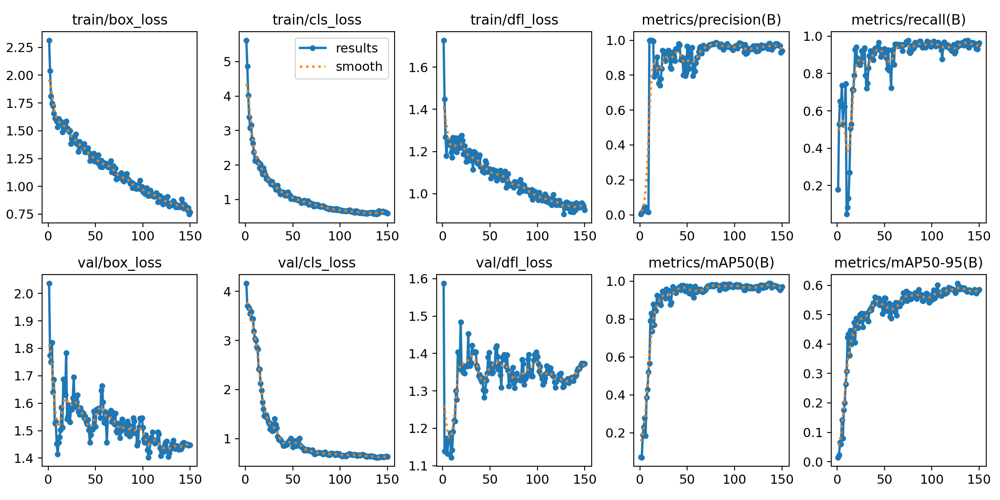

In [16]:
from PIL import Image
Image.open("runs/detect/train/results.png")

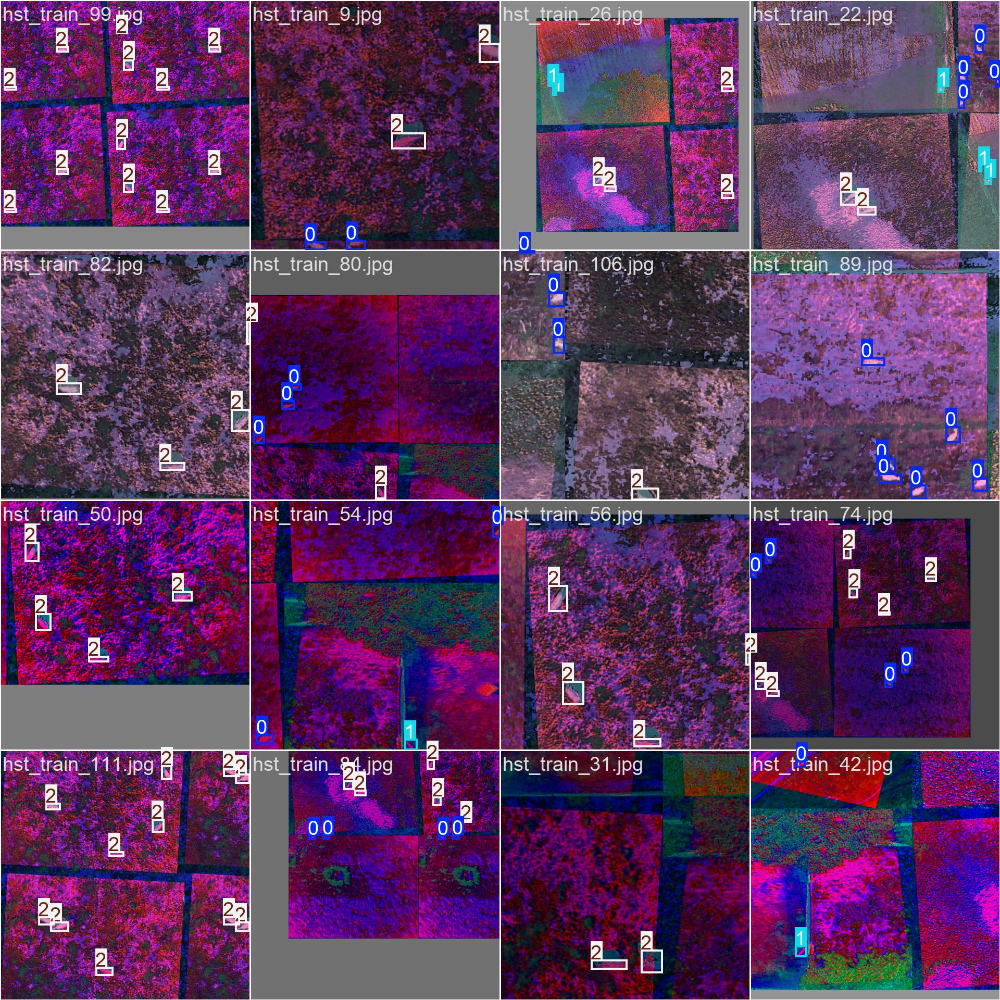

In [17]:
from PIL import Image
import matplotlib.pyplot as plt


# Rutas a las imágenes
ruta1 = "runs/detect/train/train_batch0.jpg"
ruta2 = "runs/detect/train/val_batch0_pred.jpg"

    # Cargar imágenes con PIL
Image.open("runs/detect/train/train_batch0.jpg")

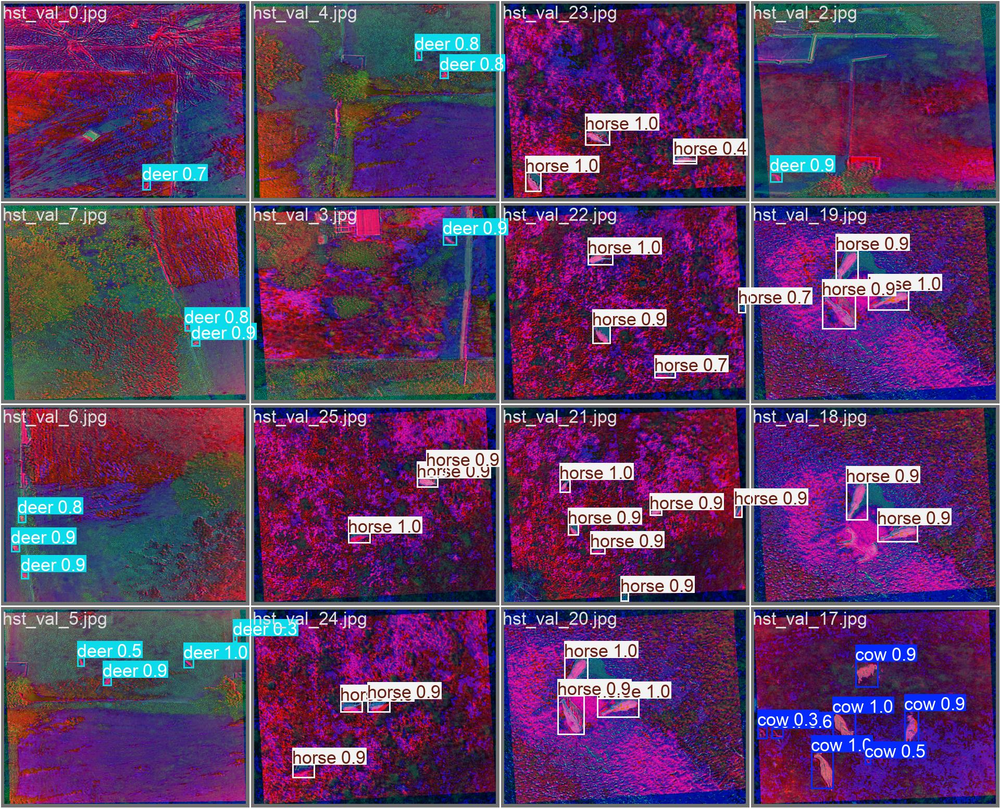

In [18]:
Image.open("runs/detect/train/val_batch0_pred.jpg")


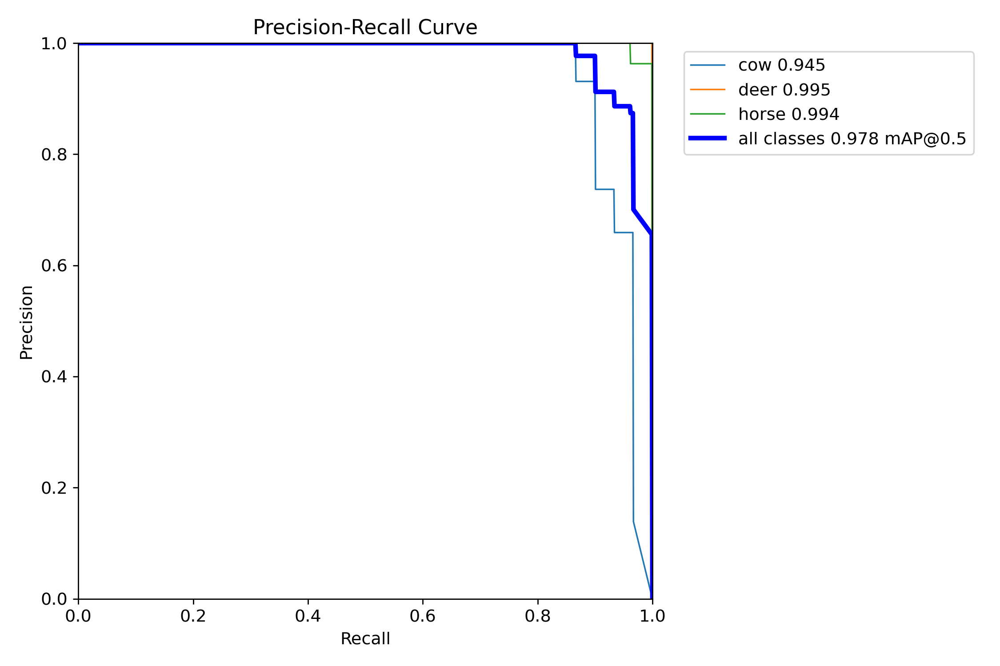

In [19]:
Image.open("runs/detect/train/PR_curve.png")

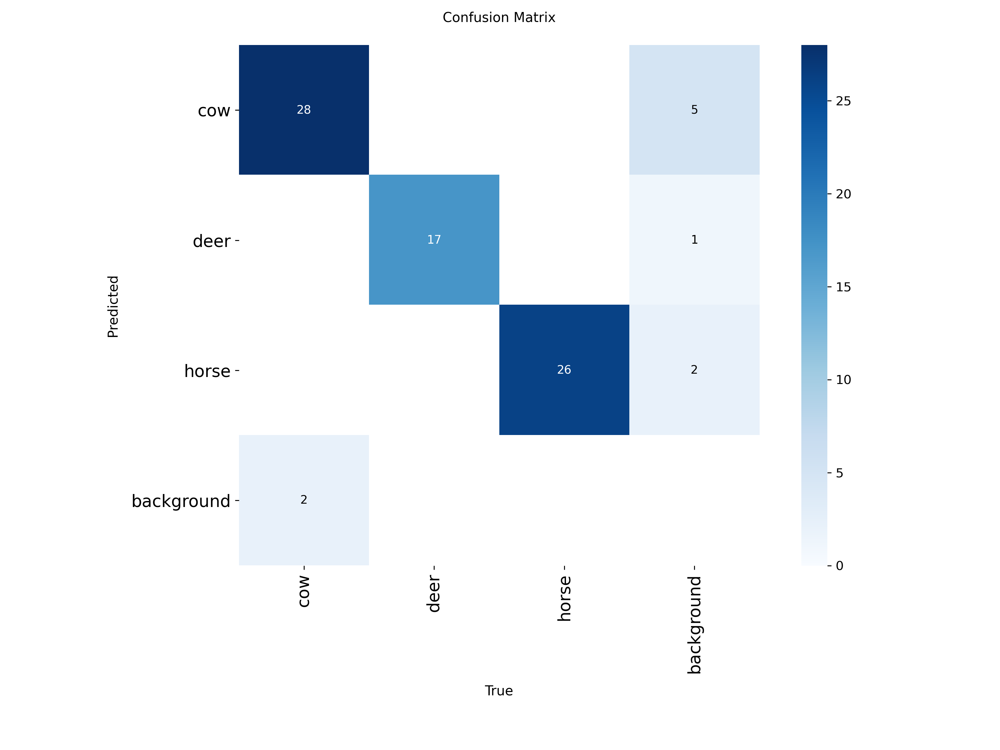

In [20]:
Image.open("runs/detect/train/confusion_matrix.png")